# Visualizing CARLA and KITTI dataset

In [1]:
import os

import numpy as np
import plotly.express as px
from imageio import imread
import xarray as xr

### If plotly, xarray, imageio are not installed yet, uncomment the cells below

In [2]:
# !pip install plotly xarray imageio

In [3]:
def show_images_carousel(images, ms, labels, key: str, title: str, height:int):        
    stacked_imgs = np.stack(images, axis=0)
    stacked_ms = np.stack(ms, axis=0)
    stacked = np.concatenate((stacked_imgs, ms), axis=1)
    xrData = xr.DataArray(
        data   = stacked,
        dims   = [key, 'row', 'col', 'rgb'],
        coords = {key: labels}
    )
    # Hide the axes
    layout_dict = dict(yaxis_visible=False, yaxis_showticklabels=False, xaxis_visible=False, xaxis_showticklabels=False)
    return px.imshow(xrData, title=title, animation_frame=key).update_layout(layout_dict)

def show_images_carousel_from_urls(image_urls, motion_seg_urls, labels, key: str, title:str, height:int):
    images = [imread(url, pilmode='RGB') for url in image_urls]
    ms = [imread(url, pilmode='RGB') for url in motion_seg_urls]
    return show_images_carousel(images, ms, labels, key, title, height)

root = "/storage/remote/atcremers40/motion_seg/datasets"

## Visualizing sample CARLA images

In [4]:
images = {
    str(os.path.join(root, "Carla_unsupervised/images/0000/0150.png")): 'Carla 0',
    str(os.path.join(root, "Carla_unsupervised/images/0001/0150.png")): 'Carla 1',
    str(os.path.join(root, "Carla_unsupervised/images/0002/0150.png")): 'Carla 2',
    str(os.path.join(root, "Carla_unsupervised/images/0003/0150.png")): 'Carla 3',
    str(os.path.join(root, "Carla_unsupervised/images/0004/0150.png")): 'Carla 4'
}

motion_seg = {
    str(os.path.join(root, "Carla_unsupervised/motion_segmentation/0000/0150.png")): 'Carla 0',
    str(os.path.join(root, "Carla_unsupervised/motion_segmentation/0001/0150.png")): 'Carla 1',
    str(os.path.join(root, "Carla_unsupervised/motion_segmentation/0002/0150.png")): 'Carla 2',
    str(os.path.join(root, "Carla_unsupervised/motion_segmentation/0003/0150.png")): 'Carla 3',
    str(os.path.join(root, "Carla_unsupervised/motion_segmentation/0004/0150.png")): 'Carla 4'
}


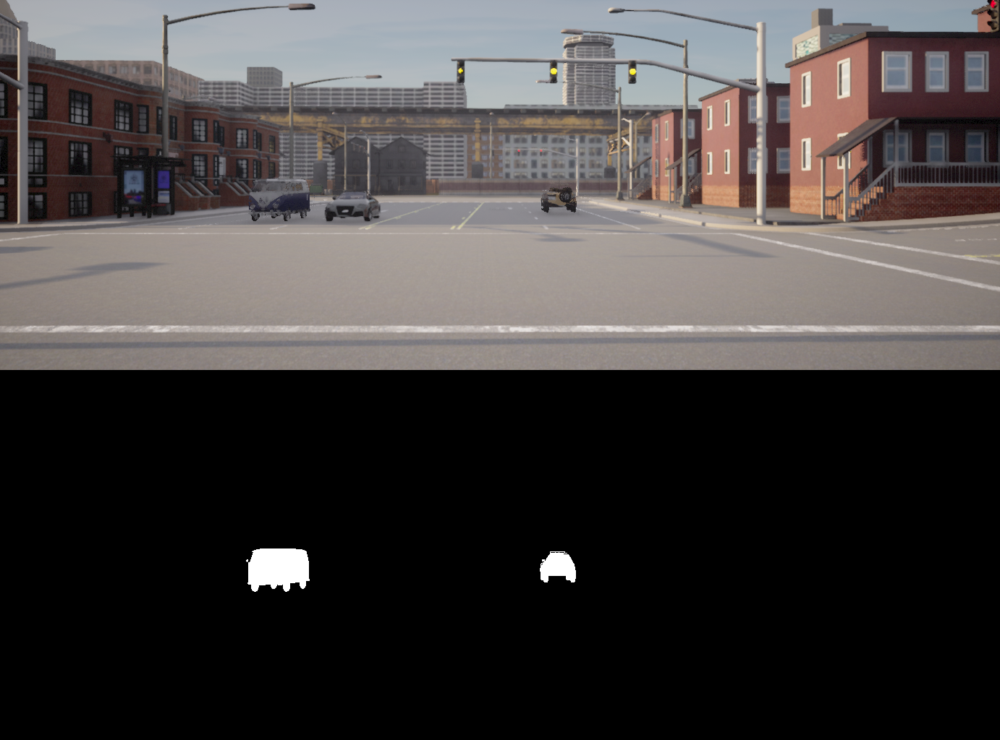
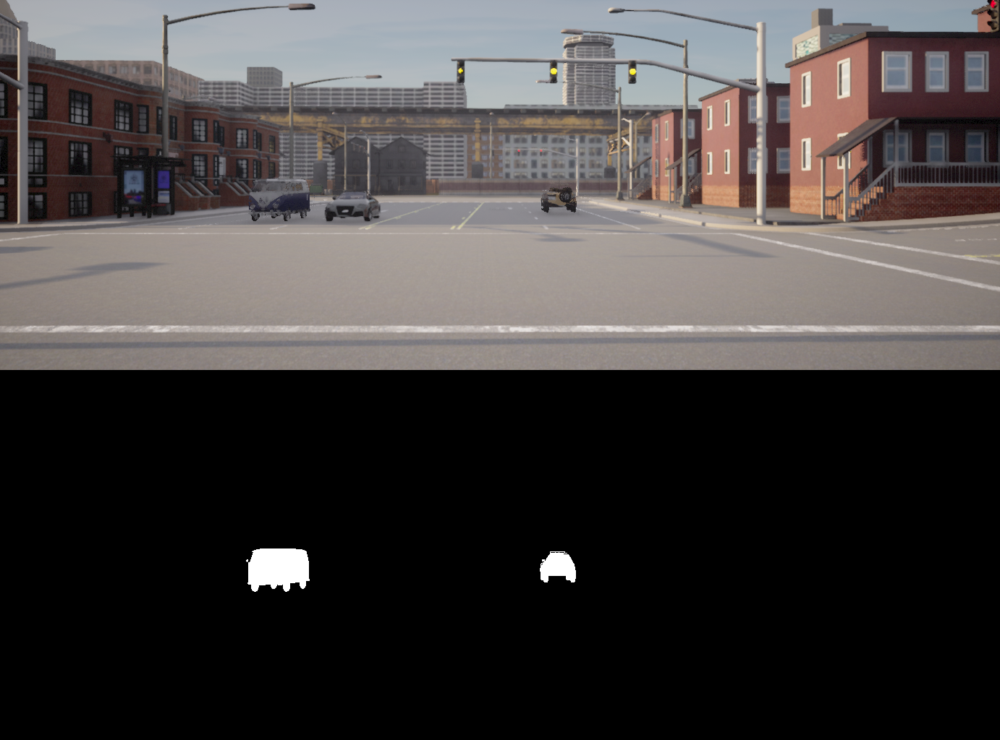
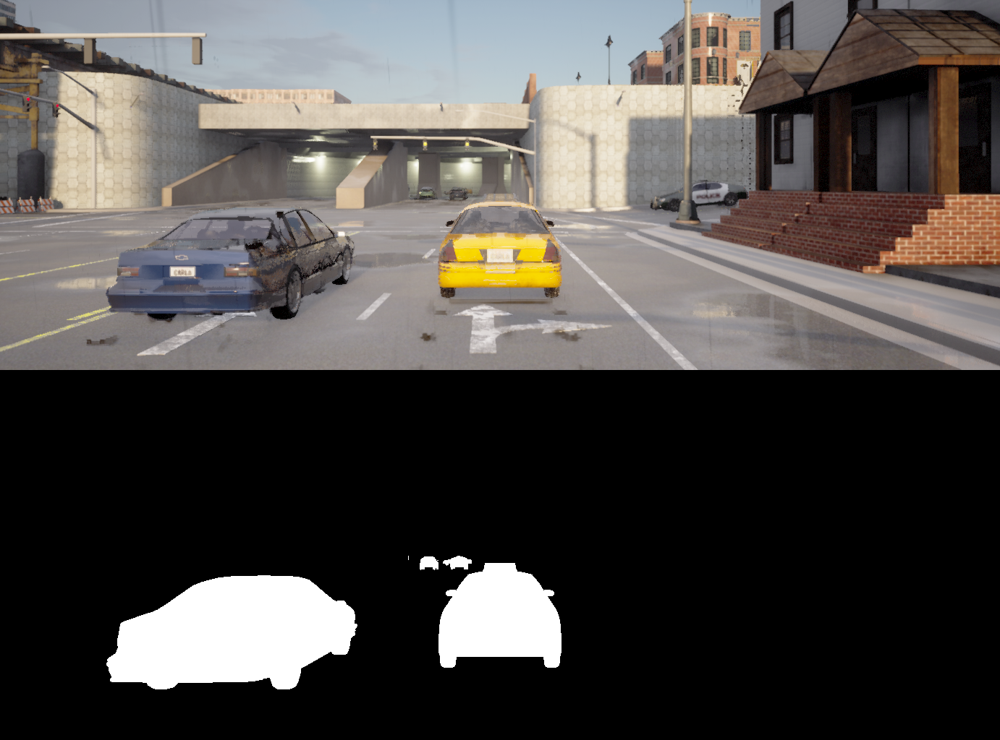
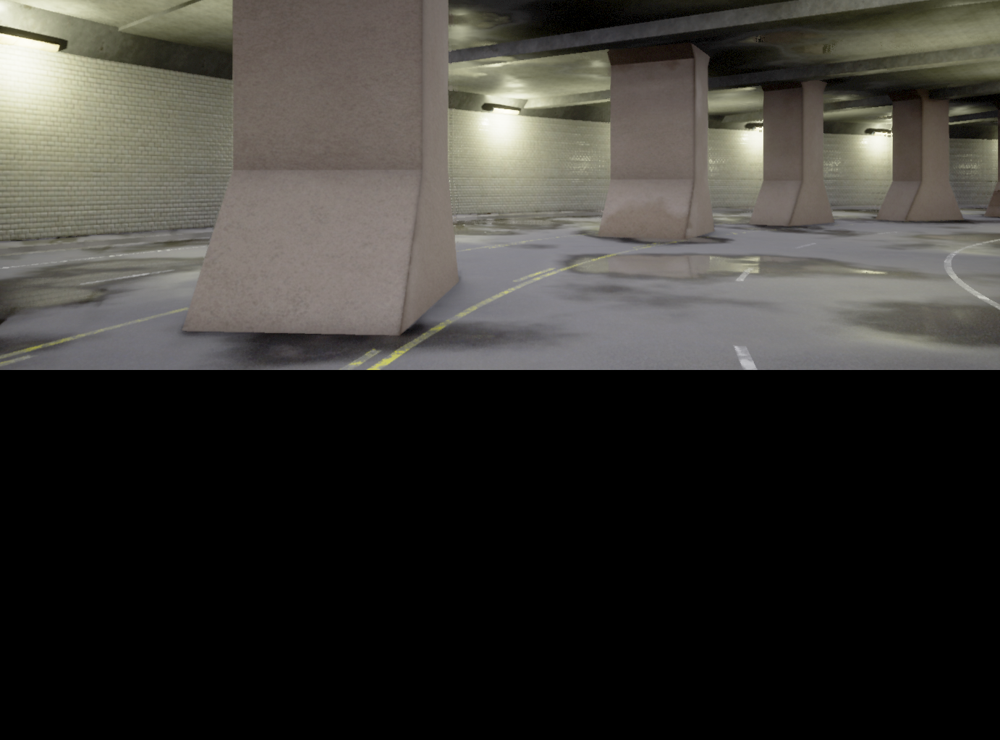
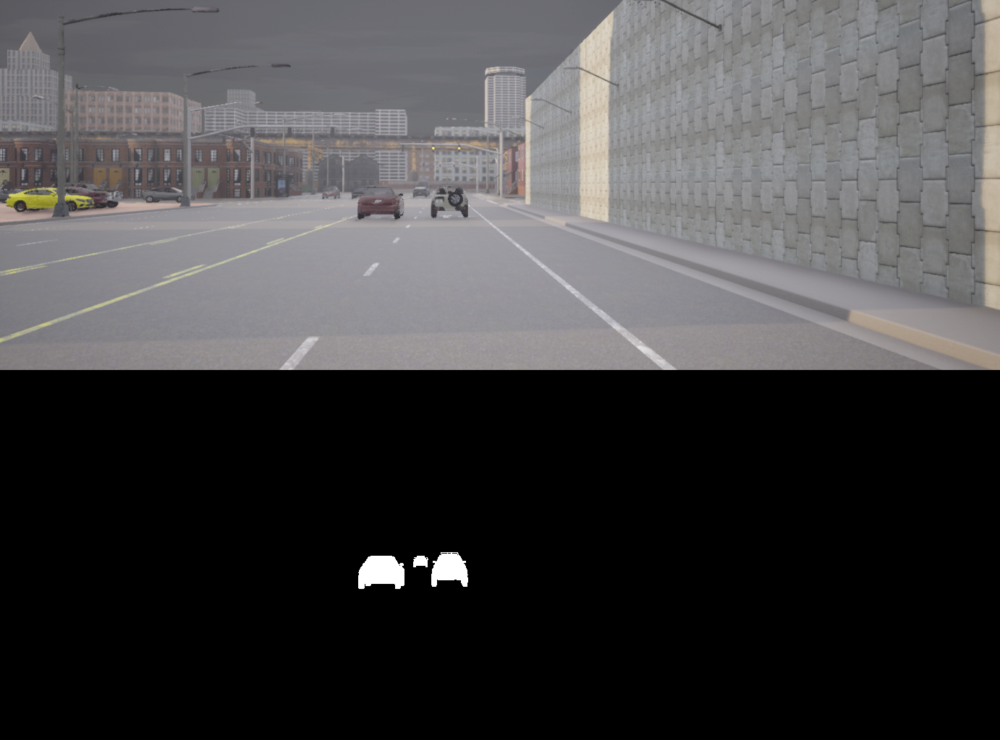
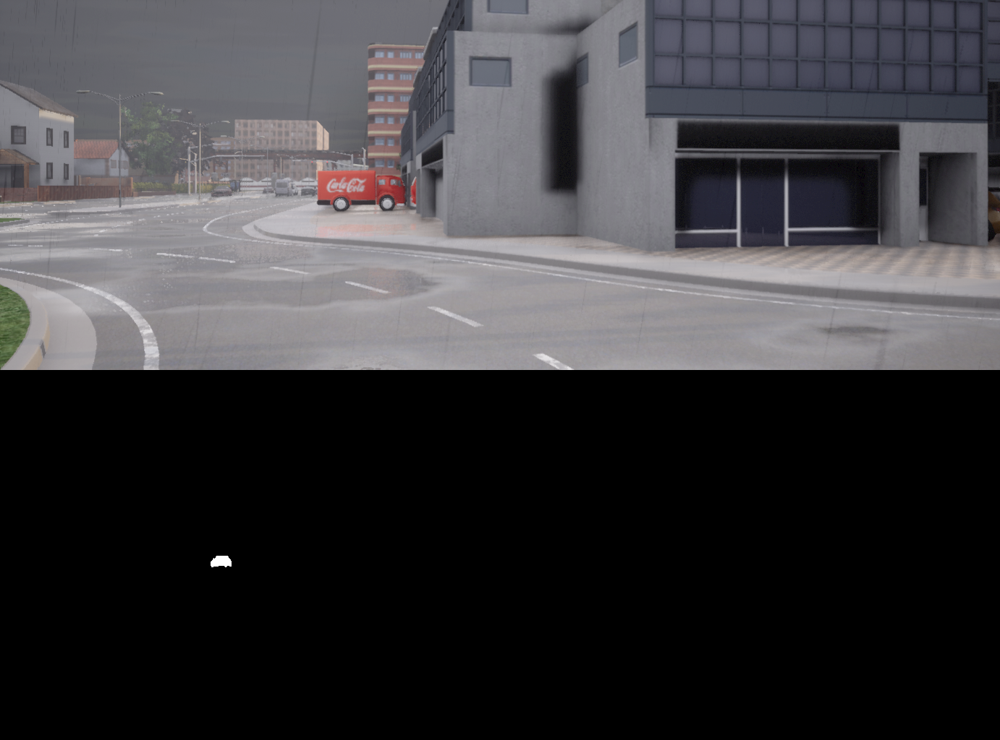

In [5]:
fig = show_images_carousel_from_urls (images.keys(), motion_seg.keys(), list(images.values()), 'Method', None, 700)
fig.show()

## Visualizing sample KITTI images

In [6]:
images_KITTI = {
    str(os.path.join(root, "Extended_MOD_Masks/images/2011_09_26_drive_0002_sync/data/0000000070.png")): 'KITTI_2',
    str(os.path.join(root, "Extended_MOD_Masks/images/2011_09_26_drive_0005_sync/data/0000000150.png")): 'KITTI_5', 
    str(os.path.join(root, "Extended_MOD_Masks/images/2011_09_26_drive_0009_sync/data/0000000150.png")): 'KITTI_9',
    str(os.path.join(root, "Extended_MOD_Masks/images/2011_09_26_drive_0011_sync/data/0000000150.png")): 'KITTI_11', 
    str(os.path.join(root, "Extended_MOD_Masks/images/2011_09_26_drive_0013_sync/data/0000000070.png")): 'KITTI_13'
}

images_KITTI_ms = {
    str(os.path.join(root, "Extended_MOD_Masks/masks/2011_09_26_drive_0002_sync/image_02/0000000070.png")): 'KITTI_2',
    str(os.path.join(root, "Extended_MOD_Masks/masks/2011_09_26_drive_0005_sync/image_02/0000000150.png")): 'KITTI_5', 
    str(os.path.join(root, "Extended_MOD_Masks/masks/2011_09_26_drive_0009_sync/image_02/0000000150.png")): 'KITTI_9',
    str(os.path.join(root, "Extended_MOD_Masks/masks/2011_09_26_drive_0011_sync/image_02/0000000150.png")): 'KITTI_11', 
    str(os.path.join(root, "Extended_MOD_Masks/masks/2011_09_26_drive_0013_sync/image_02/0000000070.png")): 'KITTI_13'
}


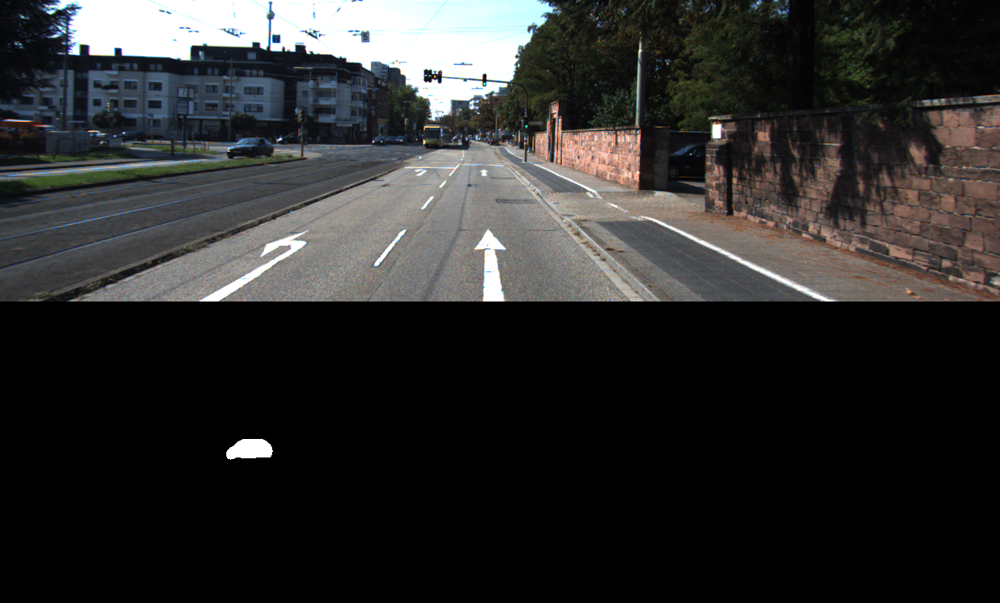
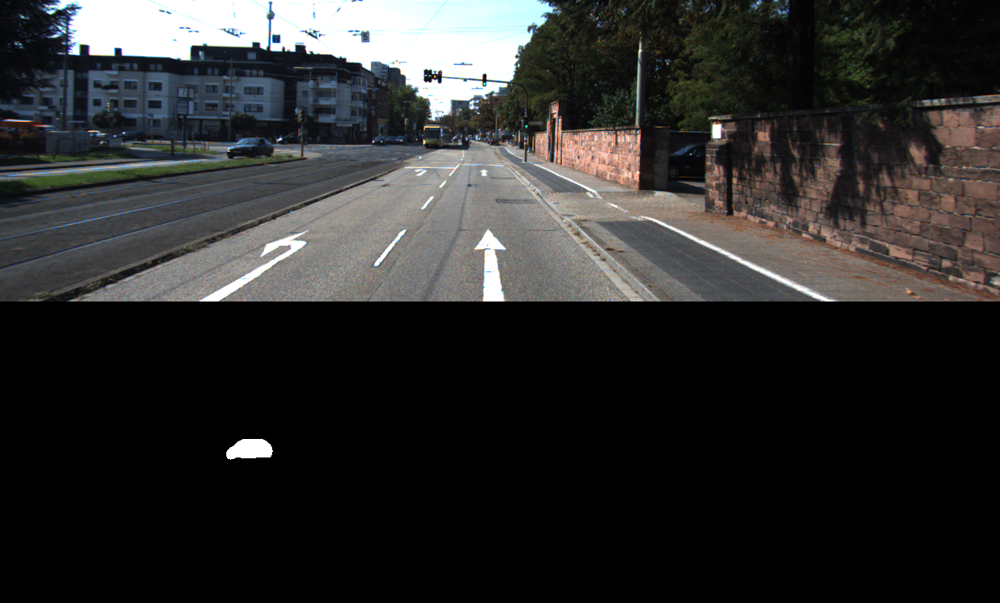
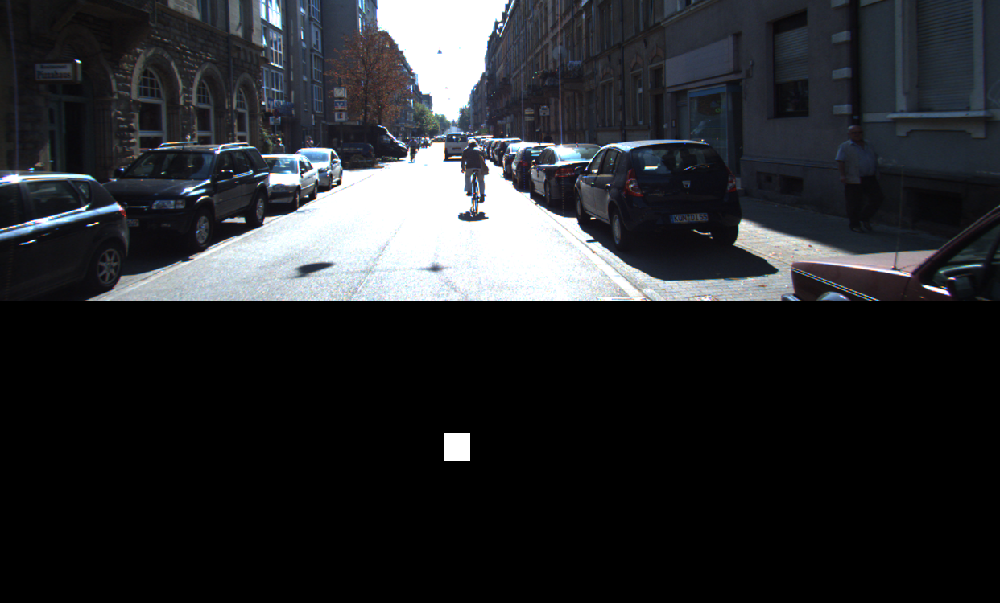
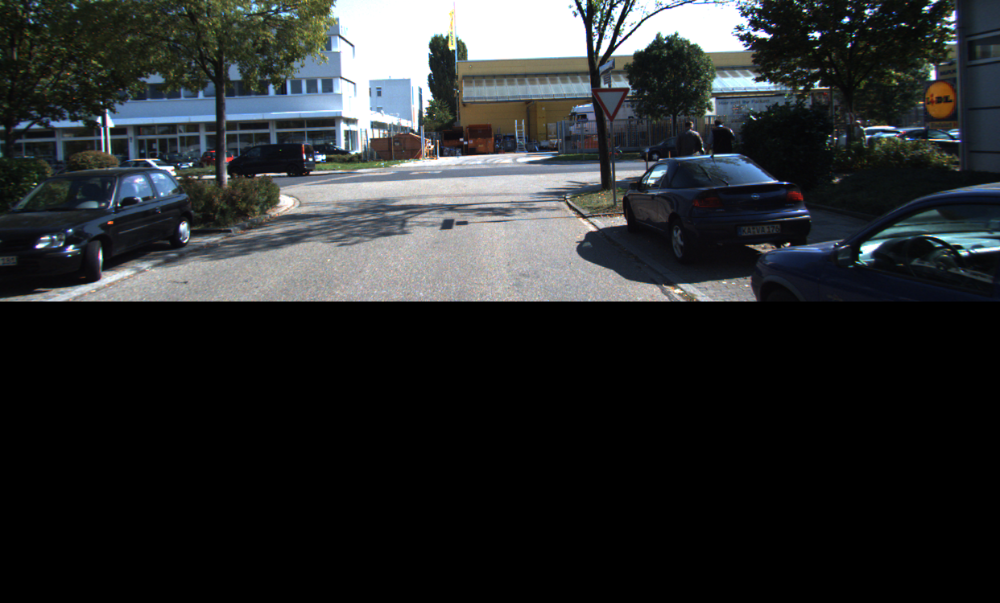
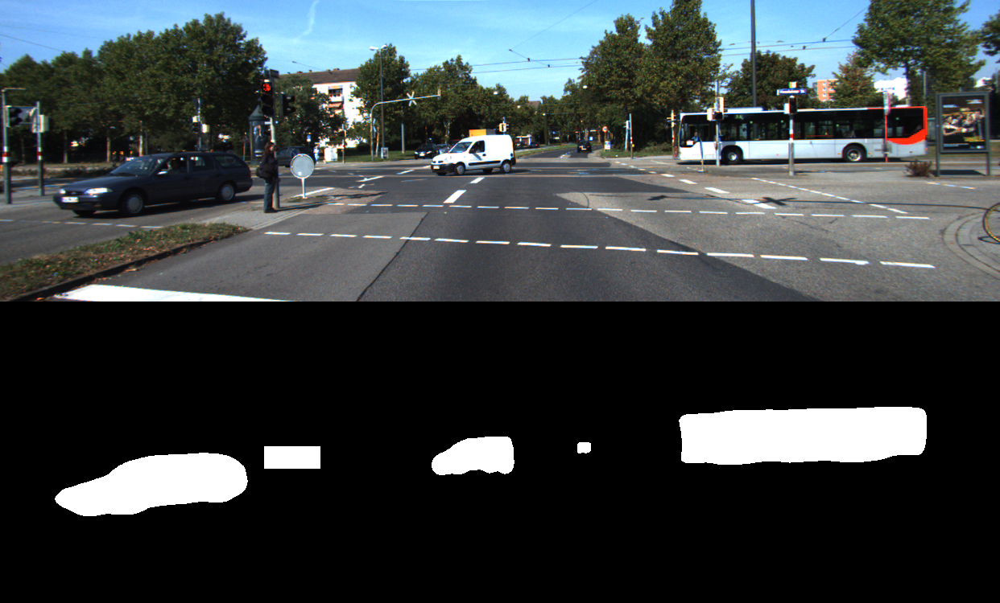
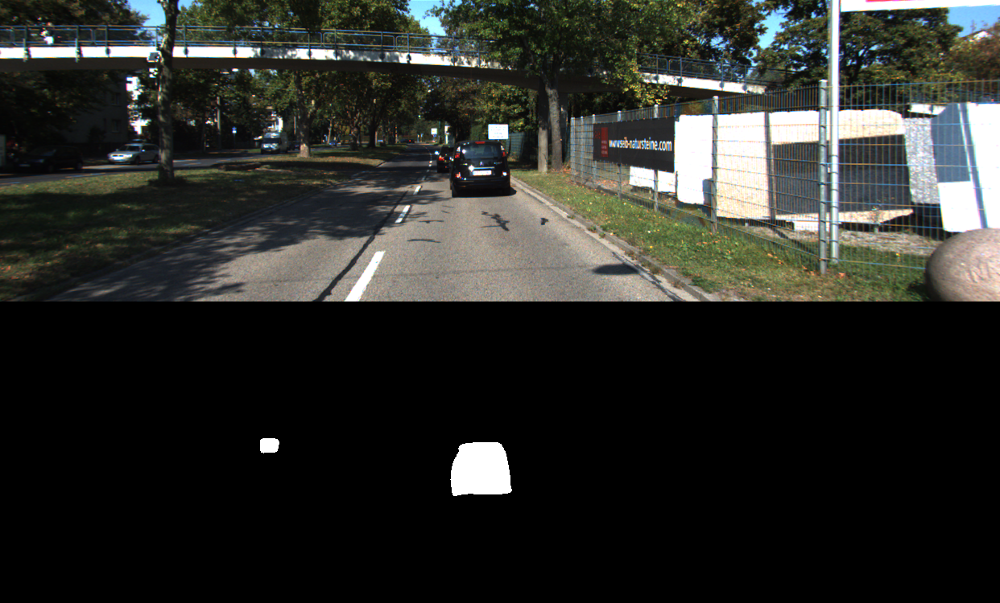

In [7]:
fig = show_images_carousel_from_urls (images_KITTI.keys(), images_KITTI_ms.keys(), list(images_KITTI.values()), 'Method', None, 700)
fig.show()